In [1]:
#%pip install distributed
#%pip install pystac_client
#%pip install scikit-image
#%pip install geopandas
#%pip install rasterio
#%pip install cartopy
#%pip install matplotlib
#%pip install numpy

Part 1: Pre fire baseline

Connect to the Microsoft Planetary Computer STAC catalog and search for Sentinel-2 L2A imagery over the study area for June 3, 2025 (one week before the fire).

In [2]:
#%pip install odc 
#%pip install odc-stac
#%pip install pyproj

In [3]:
import matplotlib.pyplot as plt
import numpy as np
import numpy.typing as npt
import odc.stac
import planetary_computer
from distributed import LocalCluster
from IPython.display import Image
from matplotlib.colors import BoundaryNorm, ListedColormap
from pystac_client import Client
from scipy.stats import gaussian_kde
from skimage import exposure
from pyproj import Transformer

In [4]:
def_collection = "sentinel-2-l2a"  # collection
# Before the fire:
pre_f = "2025-06-03"
# After the fire:
post_f = "2025-06-21"

search_bbox = (8.847198, 40.193395, 8.938865, 40.241895)
transformer = Transformer.from_crs("EPSG:4326", "EPSG:32632", always_xy=True)

t_utm_to_deg = Transformer.from_crs("EPSG:32632","EPSG:4326", always_xy=True)

In [5]:
cluster = LocalCluster()
client = cluster.get_client()
client

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:8787/status,
Dashboard: http://127.0.0.1:8787/status,Workers: 4
Total threads: 16,Total memory: 31.68 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:57480,Workers: 0
Dashboard: http://127.0.0.1:8787/status,Total threads: 0
Started: Just now,Total memory: 0 B
Comm: tcp://127.0.0.1:57503,Total threads: 4
Dashboard: http://127.0.0.1:57507/status,Memory: 7.92 GiB
Nanny: tcp://127.0.0.1:57483,


In [6]:
catalog = Client.open(
    "https://planetarycomputer.microsoft.com/api/stac/v1",
    modifier=planetary_computer.sign_inplace,
)

items = list(
    catalog.search(
        bbox=search_bbox,
        datetime=f"{pre_f}T00:00:00Z/{pre_f}T23:59:59Z",
        collections="sentinel-2-l2a",
    ).item_collection()
)

print(f"Total Items Found for Sentinel-2 L2A over Sardinia: {len(items)}")

Total Items Found for Sentinel-2 L2A over Sardinia: 1


In [7]:
items[0]

<Item id=S2A_MSIL2A_20250603T101041_R022_T32TMK_20250603T134103>

In [8]:
Image(url=items[0].assets["rendered_preview"].href)

In [9]:
# Load data using odc-stac
data = odc.stac.load(
    items,
    bands=["B04", "B03", "B02", "B8A", "B12", "SCL"],
    bbox=search_bbox,
    chunks={},
)

# Get metadata from the STAC item directly
item = items[0]
date = item.datetime.strftime("%Y-%m-%d")
time_val = item.datetime.strftime("%H:%M:%S")
target_crs = item.properties.get("proj:epsg")

print(f"Item for the {date} at {time_val}")

Item for the 2025-06-03 at 10:10:41


Text(0.5, 1.0, 'Green Reflectance (B03)')

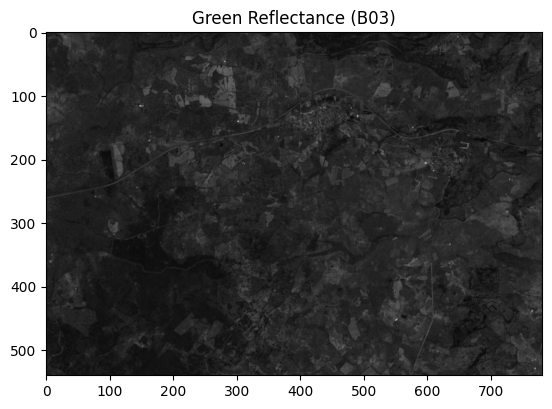

In [10]:
# Cloud mask using SCL
scl = data["SCL"].squeeze()
valid_mask = scl.isin([2, 4, 5, 6, 7, 11])

# Apply mask to bands
red = data["B04"].squeeze().where(valid_mask)
grn = data["B03"].squeeze().where(valid_mask)
blu = data["B02"].squeeze().where(valid_mask)

# Compute
red = red.compute()
grn = grn.compute()
blu = blu.compute()

# Visualize
plt.imshow(grn.values, cmap="gray")
plt.title("Green Reflectance (B03)")

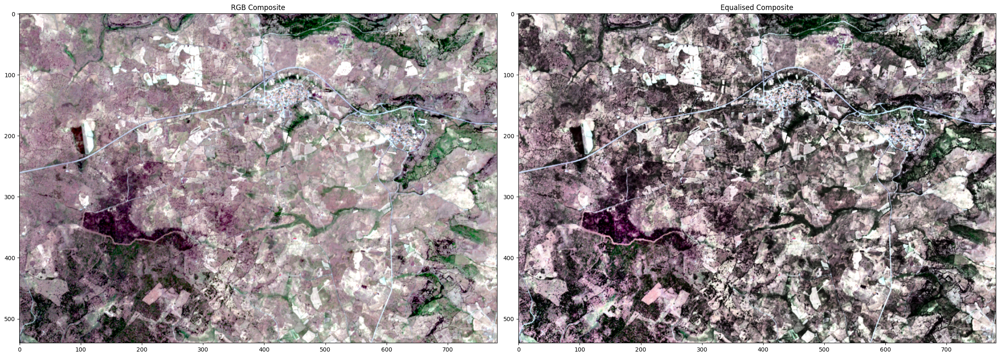

In [11]:
def normalisation_str_gm(
    band_array: npt.NDArray, p_min: float, p_max: float, gamma_val: float
) -> npt.NDArray:
    """
    Applies percentile-based contrast stretching and gamma correction to a band.

    Recieves:

    - band_array (xarray) : the extracted `xarray` for the selected band
    - p_min (int): percentile min value
    - p_max (int): percentile max value
    - gamma_val (int): gamma correction

    Returns:
    - 2d array with the normalised input values
    """

    # Calculate min and max values based on percentiles for stretching
    min_val = (
        np.percentile(band_array[band_array > 0], p_min)
        if np.any(band_array > 0)
        else 0
    )
    max_val = (
        np.percentile(band_array[band_array > 0], p_max)
        if np.any(band_array > 0)
        else 1
    )

    # Avoid division by zero if min_val equals max_val
    if max_val == min_val:
        stretched_band = np.zeros_like(band_array, dtype=np.float32)
    else:
        # Linear stretch to 0-1 range
        stretched_band = (band_array - min_val) / (max_val - min_val)

    # Clip values to ensure they are within [0, 1] after stretching
    stretched_band[stretched_band < 0] = 0
    stretched_band[stretched_band > 1] = 1

    # Apply gamma correction
    gamma_corrected_band = np.power(stretched_band, 1.0 / gamma_val)

    # Returns the corrected array:
    return gamma_corrected_band


# Normalize bands
contrast_stretch_percentile = (2, 98)
gamma = 1.8

red_processed = normalisation_str_gm(red.values, *contrast_stretch_percentile, gamma)
grn_processed = normalisation_str_gm(grn.values, *contrast_stretch_percentile, gamma)
blu_processed = normalisation_str_gm(blu.values, *contrast_stretch_percentile, gamma)

# Stack to RGB
rgb = np.dstack([red_processed, grn_processed, blu_processed]).astype(np.float32)

# Equalize
rgb_eq = exposure.equalize_adapthist(rgb)

# Plot side by side
fig, axes = plt.subplots(1, 2, figsize=(24, 10))
axes[0].imshow(rgb)
axes[0].set_title("RGB Composite")
axes[1].imshow(rgb_eq)
axes[1].set_title("Equalised Composite")
plt.tight_layout()

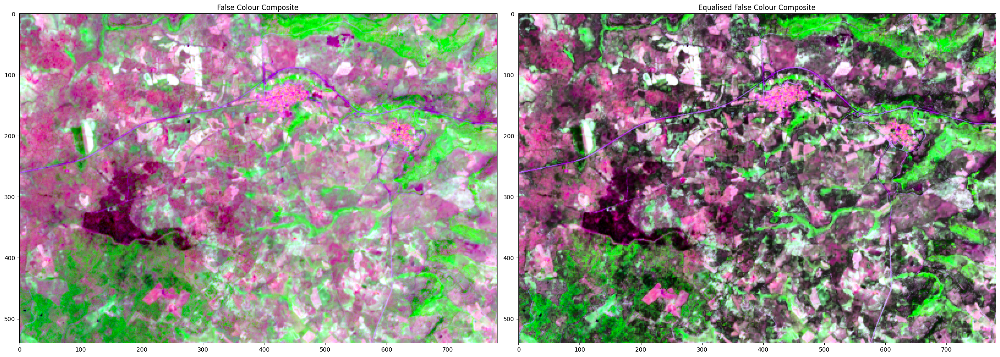

In [12]:
# False color composite (SWIR, NIR, Blue)
swir = data["B12"].squeeze().where(valid_mask).compute()
nir = data["B8A"].squeeze().where(valid_mask).compute()

# Normalize
swir_processed = normalisation_str_gm(swir.values, *contrast_stretch_percentile, gamma)
nir_processed = normalisation_str_gm(nir.values, *contrast_stretch_percentile, gamma)
blu_processed = normalisation_str_gm(blu.values, *contrast_stretch_percentile, gamma)

# Stack and equalize
false_rgb = np.dstack([swir_processed, nir_processed, blu_processed]).astype(np.float32)
false_rgb_eq = exposure.equalize_adapthist(false_rgb)

# Plot side by side
fig, axes = plt.subplots(1, 2, figsize=(24, 10))
axes[0].imshow(false_rgb)
axes[0].set_title("False Colour Composite")
axes[1].imshow(false_rgb_eq)
axes[1].set_title("Equalised False Colour Composite")
plt.tight_layout()

Part 2: Post fire comparison

Post-fire items found: 1


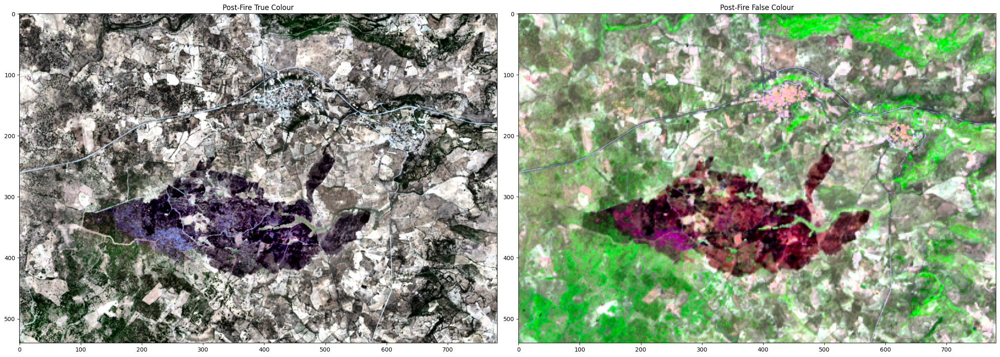

In [13]:
# Post-fire image
post_f = "2025-06-21"

post_items = list(
    catalog.search(
        bbox=search_bbox,
        datetime=f"{post_f}T00:00:00Z/{post_f}T23:59:59Z",
        collections="sentinel-2-l2a",
    ).item_collection()
)

print(f"Post-fire items found: {len(post_items)}")

# Load post-fire data
data_post = odc.stac.load(
    post_items,
    bands=["B04", "B03", "B02", "B8A", "B12", "SCL"],
    bbox=search_bbox,
    chunks={},
)

# Cloud mask
scl_post = data_post["SCL"].squeeze()
valid_mask_post = scl_post.isin([2, 4, 5, 6, 7, 11])

# True color bands
red_post = data_post["B04"].squeeze().where(valid_mask_post).compute()
grn_post = data_post["B03"].squeeze().where(valid_mask_post).compute()
blu_post = data_post["B02"].squeeze().where(valid_mask_post).compute()

# False color bands
swir_post = data_post["B12"].squeeze().where(valid_mask_post).compute()
nir_post = data_post["B8A"].squeeze().where(valid_mask_post).compute()

# True color composite
red_proc = normalisation_str_gm(red_post.values, *contrast_stretch_percentile, gamma)
grn_proc = normalisation_str_gm(grn_post.values, *contrast_stretch_percentile, gamma)
blu_proc = normalisation_str_gm(blu_post.values, *contrast_stretch_percentile, gamma)
tc_post = np.dstack([red_proc, grn_proc, blu_proc]).astype(np.float32)
tc_post_eq = exposure.equalize_adapthist(tc_post)

# False color composite
swir_proc = normalisation_str_gm(swir_post.values, *contrast_stretch_percentile, gamma)
nir_proc = normalisation_str_gm(nir_post.values, *contrast_stretch_percentile, gamma)
fc_post = np.dstack([swir_proc, nir_proc, blu_proc]).astype(np.float32)
fc_post_eq = exposure.equalize_adapthist(fc_post)

# Plot
fig, axes = plt.subplots(1, 2, figsize=(24, 10))
axes[0].imshow(tc_post_eq)
axes[0].set_title("Post-Fire True Colour")
axes[1].imshow(fc_post_eq)
axes[1].set_title("Post-Fire False Colour")
plt.tight_layout()

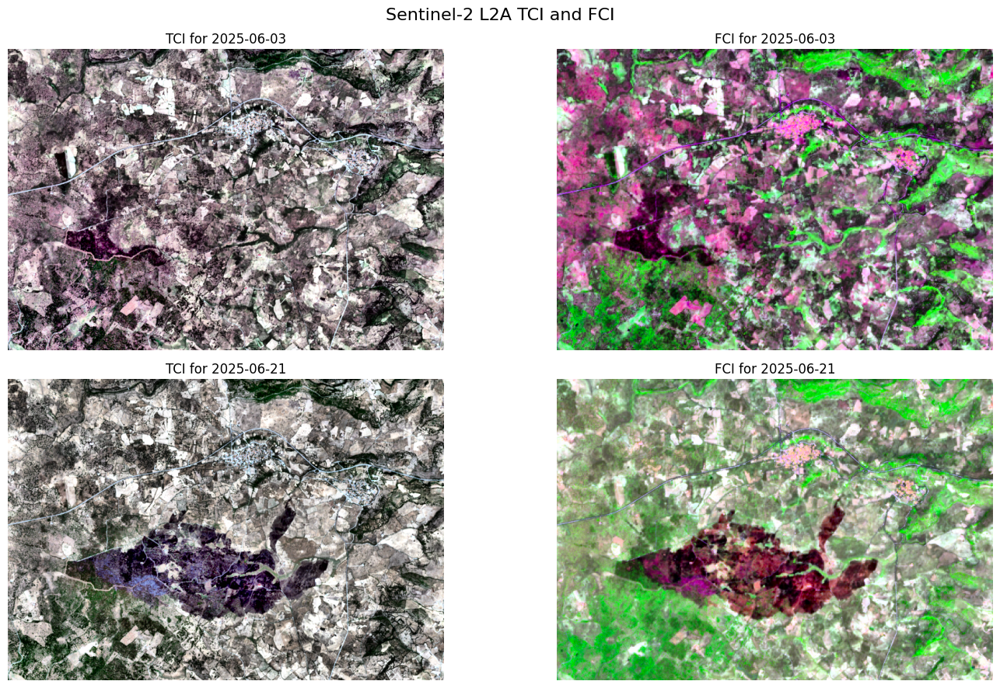

In [14]:
# Simplified visualization without geographic coordinates
fig, axs = plt.subplots(2, 2, figsize=(15, 9))

# Pre fire TCI
axs[0, 0].imshow(rgb_eq)
axs[0, 0].set_title(f"TCI for {pre_f}")
axs[0, 0].axis("off")

# Pre fire FCI
axs[0, 1].imshow(false_rgb_eq)
axs[0, 1].set_title(f"FCI for {pre_f}")
axs[0, 1].axis("off")

# Post fire TCI
axs[1, 0].imshow(tc_post_eq)
axs[1, 0].set_title(f"TCI for {post_f}")
axs[1, 0].axis("off")

# Post fire FCI
axs[1, 1].imshow(fc_post_eq)
axs[1, 1].set_title(f"FCI for {post_f}")
axs[1, 1].axis("off")

fig.suptitle("Sentinel-2 L2A TCI and FCI", fontsize=16)
plt.tight_layout()
plt.show()

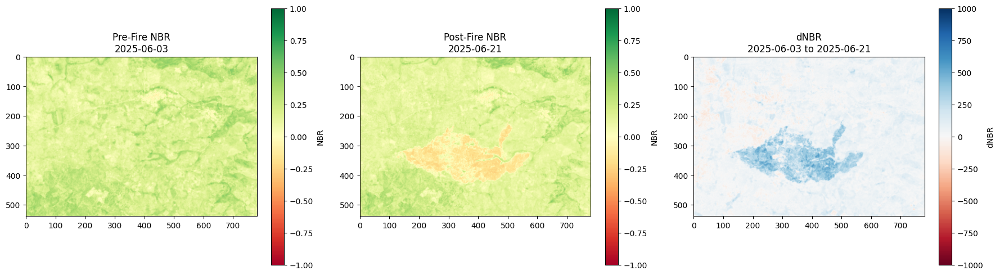

In [15]:
# NBR Calculation using Planetary Computer data
# Pre-fire NBR
nir_pre = data["B8A"].squeeze().where(valid_mask).compute()
swir_pre = data["B12"].squeeze().where(valid_mask).compute()

nir_pre_vals = nir_pre.values.astype(float)
swir_pre_vals = swir_pre.values.astype(float)

nbr_pre = np.where(
    (nir_pre_vals + swir_pre_vals) == 0,
    0,
    (nir_pre_vals - swir_pre_vals) / (nir_pre_vals + swir_pre_vals),
)

# Post-fire NBR
nir_post_vals = nir_post.values.astype(float)
swir_post_vals = swir_post.values.astype(float)

nbr_post = np.where(
    (nir_post_vals + swir_post_vals) == 0,
    0,
    (nir_post_vals - swir_post_vals) / (nir_post_vals + swir_post_vals),
)

# dNBR
dNBR = (nbr_pre - nbr_post) * 1000

# Consolidated visualization
fig, axs = plt.subplots(1, 3, figsize=(18, 5))

im0 = axs[0].imshow(nbr_pre, vmin=-1.0, vmax=1.0, cmap="RdYlGn")
axs[0].set_title(f"Pre-Fire NBR\n{pre_f}")
plt.colorbar(im0, ax=axs[0], label="NBR")

im1 = axs[1].imshow(nbr_post, vmin=-1.0, vmax=1.0, cmap="RdYlGn")
axs[1].set_title(f"Post-Fire NBR\n{post_f}")
plt.colorbar(im1, ax=axs[1], label="NBR")

im2 = axs[2].imshow(dNBR, vmin=-1000, vmax=1000, cmap="RdBu")
axs[2].set_title(f"dNBR\n{pre_f} to {post_f}")
plt.colorbar(im2, ax=axs[2], label="dNBR")

plt.tight_layout()
plt.show()

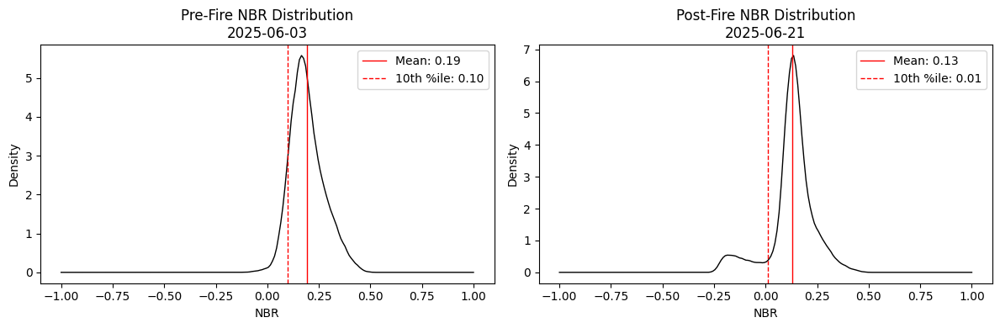

In [16]:
# Pre- and Post-fire NBR Density Plots
fig, axs = plt.subplots(1, 2, figsize=(12, 4))

# Flatten and remove NaN values
nbr_pre_flat = nbr_pre.flatten()
nbr_pre_flat = nbr_pre_flat[~np.isnan(nbr_pre_flat)]

nbr_post_flat = nbr_post.flatten()
nbr_post_flat = nbr_post_flat[~np.isnan(nbr_post_flat)]

# Calculate statistics
pre_mean = np.mean(nbr_pre_flat)
pre_p10 = np.percentile(nbr_pre_flat, 10)
post_mean = np.mean(nbr_post_flat)
post_p10 = np.percentile(nbr_post_flat, 10)

# Create density estimates
x = np.linspace(-1, 1, 200)
kde_pre = gaussian_kde(nbr_pre_flat)
kde_post = gaussian_kde(nbr_post_flat)

axs[0].plot(x, kde_pre(x), color="black", linewidth=1)
axs[0].axvline(
    x=pre_mean, color="red", linestyle="-", linewidth=1, label=f"Mean: {pre_mean:.2f}"
)
axs[0].axvline(
    x=pre_p10,
    color="red",
    linestyle="--",
    linewidth=1,
    label=f"10th %ile: {pre_p10:.2f}",
)
axs[0].set_title(f"Pre-Fire NBR Distribution\n{pre_f}")
axs[0].set_xlabel("NBR")
axs[0].set_ylabel("Density")
axs[0].legend()

axs[1].plot(x, kde_post(x), color="black", linewidth=1)
axs[1].axvline(
    x=post_mean, color="red", linestyle="-", linewidth=1, label=f"Mean: {post_mean:.2f}"
)
axs[1].axvline(
    x=post_p10,
    color="red",
    linestyle="--",
    linewidth=1,
    label=f"10th %ile: {post_p10:.2f}",
)
axs[1].set_title(f"Post-Fire NBR Distribution\n{post_f}")
axs[1].set_xlabel("NBR")
axs[1].set_ylabel("Density")
axs[1].legend()

plt.tight_layout()
plt.show()

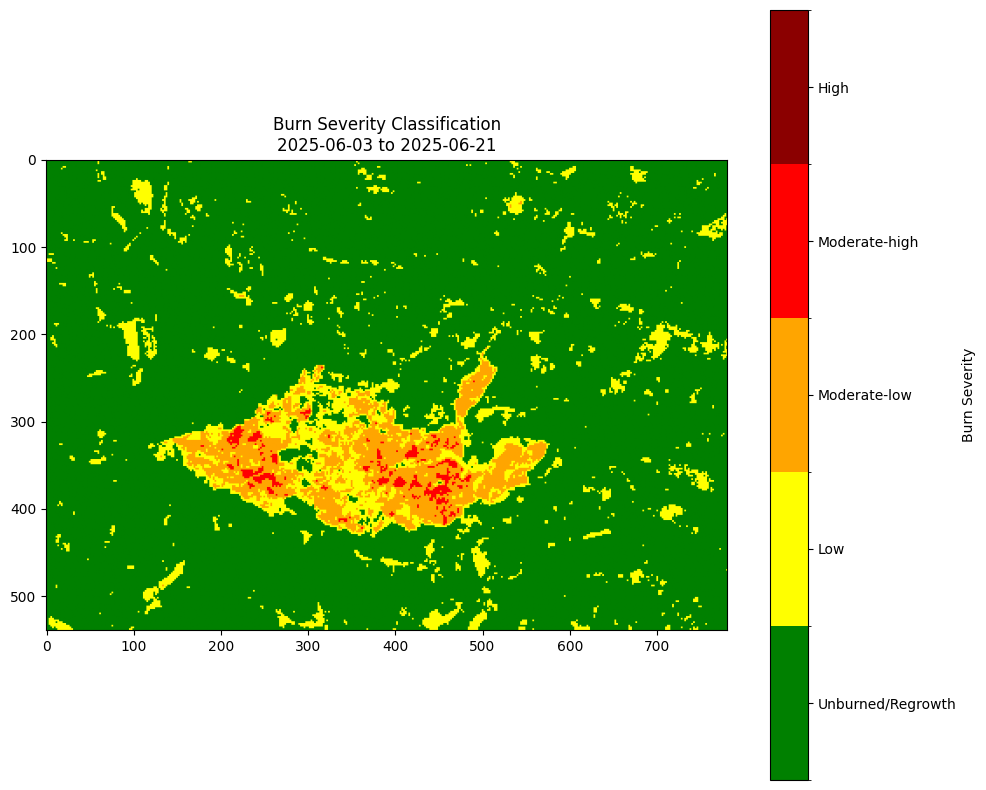

In [17]:
# Classify dNBR into burn severity categories
burn_severity = np.zeros_like(dNBR)
burn_severity = np.where(dNBR < 100, 0, burn_severity)  # Unburned / Regrowth
burn_severity = np.where((dNBR >= 100) & (dNBR < 270), 1, burn_severity)  # Low severity
burn_severity = np.where(
    (dNBR >= 270) & (dNBR < 440), 2, burn_severity
)  # Moderate-low severity
burn_severity = np.where(
    (dNBR >= 440) & (dNBR < 660), 3, burn_severity
)  # Moderate-high severity
burn_severity = np.where(dNBR >= 660, 4, burn_severity)  # High severity

colors = ["green", "yellow", "orange", "red", "darkred"]
cmap = ListedColormap(colors)
bounds = [-0.5, 0.5, 1.5, 2.5, 3.5, 4.5]
norm = BoundaryNorm(bounds, cmap.N)

# Visualization
fig, ax = plt.subplots(figsize=(10, 8))
im = ax.imshow(burn_severity, cmap=cmap, norm=norm)

cbar = plt.colorbar(im, ax=ax, ticks=[0, 1, 2, 3, 4])
cbar.ax.set_yticklabels(
    ["Unburned/Regrowth", "Low", "Moderate-low", "Moderate-high", "High"]
)
cbar.set_label("Burn Severity")

ax.set_title(f"Burn Severity Classification\n{pre_f} to {post_f}")
plt.tight_layout()
plt.show()

Found 36 items


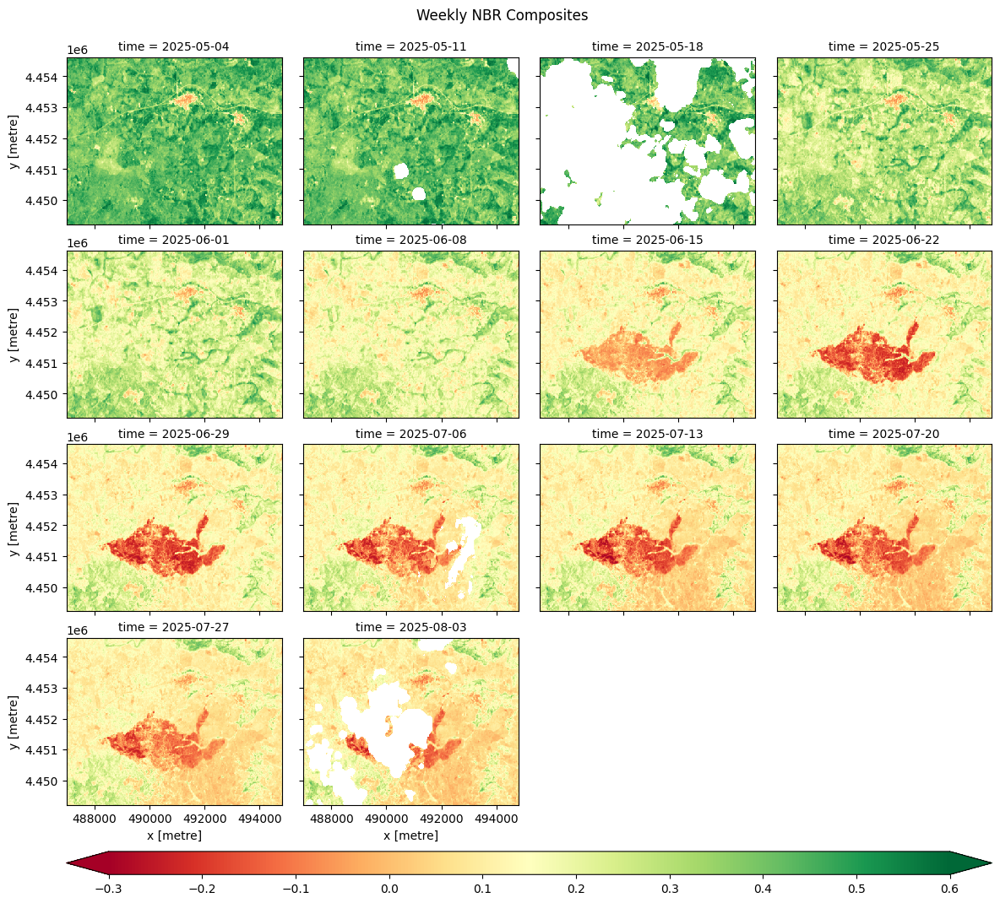

In [18]:
items = list(
    catalog.search(
        bbox=search_bbox,
        datetime="2025-05-01/2025-07-30",
        collections="sentinel-2-l2a",
        query={"eo:cloud_cover": {"lt": 30}},
    ).item_collection()
)

print(f"Found {len(items)} items")

# Load all scenes
data_ts = odc.stac.load(
    items,
    bands=["B8A", "B12", "SCL"],
    bbox=search_bbox,
    chunks={"time": 1},
)


# Calculate NBR for each timestep
def calc_nbr(nir, swir):
    nir = nir.astype(float)
    swir = swir.astype(float)
    return (nir - swir) / (nir + swir + 1e-10)


nbr_ts = calc_nbr(data_ts["B8A"], data_ts["B12"])

# Mask clouds
scl = data_ts["SCL"]
valid = scl.isin([2, 4, 5, 6, 7, 11])
nbr_ts = nbr_ts.where(valid)

# weekly composites
nbr_biweekly = nbr_ts.resample(time="1W").mean().compute()

# Compute mean NBR per weekly period within AOI
nbr_mean_biweekly = nbr_biweekly.mean(dim=["x", "y"])

# Maps with tighter range
g = nbr_biweekly.plot.imshow(
    col="time",
    col_wrap=4,
    vmin=-0.3,
    vmax=0.6,
    cmap="RdYlGn",
    figsize=(12, 12),
    cbar_kwargs={"orientation": "horizontal", "pad": 0.05, "aspect": 40},
)
plt.suptitle("Weekly NBR Composites", y=1.02)
plt.show()